In [226]:
import pandas as pd
import os
import opensoundscape
import cv2
import numpy as np
import matplotlib.pyplot as plt


In [227]:
# load datasets
CC_2004_07 = pd.read_csv('modified_annotations/MasterSheet_modification.csv')
CC_2004_07.head()

,audio_file,annotation,high_f,low_f,start_time,end_time
0,/Users/Kaitlyn/Desktop/PSTAT197/master_wav_son...,D,74,22,213.746,217.114
1,/Users/Kaitlyn/Desktop/PSTAT197/master_wav_son...,D,64,31,161.000,164.000
2,/Users/Kaitlyn/Desktop/PSTAT197/master_wav_son...,D,73,26,74.355,77.723
3,/Users/Kaitlyn/Desktop/PSTAT197/master_wav_son...,D,92,19,136.450,139.363
4,/Users/Kaitlyn/Desktop/PSTAT197/master_wav_son...,D,72,32,29.238,32.789


In [235]:
# audio file name
audio_file_name = CC_2004_07['audio_file'][1]
start_time = CC_2004_07['start_time'][1]

# collecting audio
audio = opensoundscape.Audio.from_file(audio_file_name, sample_rate=48000, offset=start_time, duration=6)

if audio.samples.shape[0] > 0:  # Assuming audio.samples returns a numpy array of audio samples
    spec = opensoundscape.Spectrogram.from_audio(audio, window_type='hamming', window_samples=24000, 
                                                     overlap_samples=21600, fft_size=48000, 
                                                     scaling='density')

# storing image as 2 dim array
spec_image = spec.bandpass(0, 200).to_image()
spec_image_arr = np.array(spec_image).astype(float)


165.0

In [268]:
# collecting portion of image containing only noise
background_noise_model = np.mean(spec_image_arr, axis=0)
background_noise_model.shape


(111,)

In [161]:
# Subtract the background noise model from each column of the spectrogram
spec_image_arr_mod2 = spec_image_arr.copy()
for i in range(spec_image_arr.shape[1]):
    spec_image_arr_mod2[:, i] -= background_noise_model[i]

In [162]:
# apply threshold to filter out parts of the background ( difference between background and foreground image)
spec_image_arr_mod3 = spec_image_arr_mod2.copy()
spec_image_arr_mod3[spec_image_arr_mod3 < 0 ] = 0

spec_image_arr_mod3.shape

(201, 111)

In [228]:
def draw_img(img_vector, h=201, w=111):
    """
    1. takes img_vector,
    2. reshapes into right dimensions,
    3. draws the resulting image
    """
    
    
    plt.imshow( (img_vector).reshape(h,w), cmap=plt.cm.gray)
    
    plt.xticks(())
    plt.yticks(())

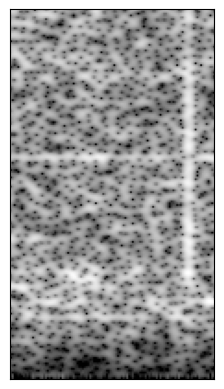

In [164]:
draw_img(spec_image_arr)

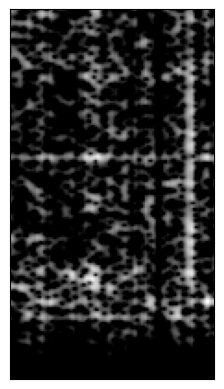

In [165]:
draw_img(spec_image_arr_mod3)

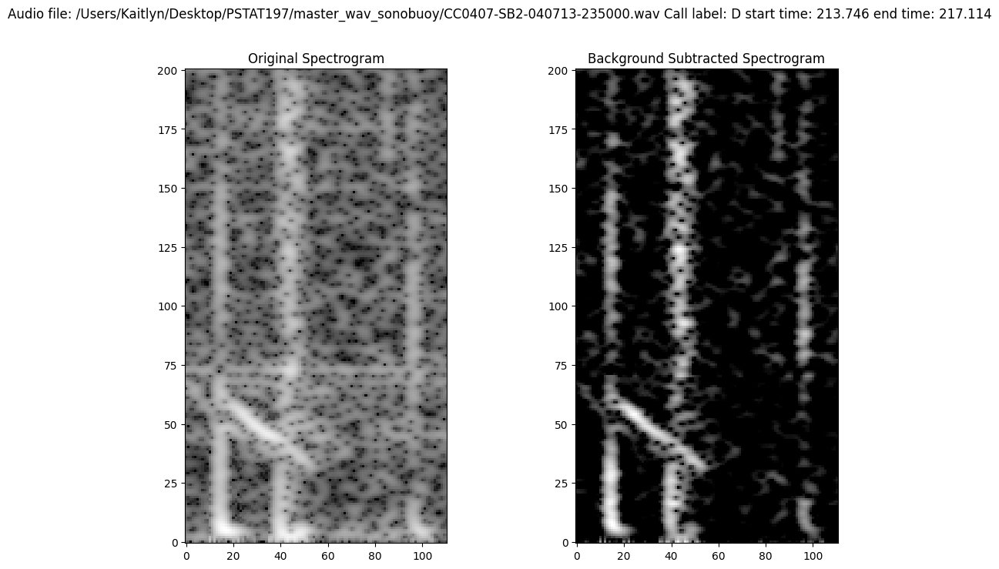

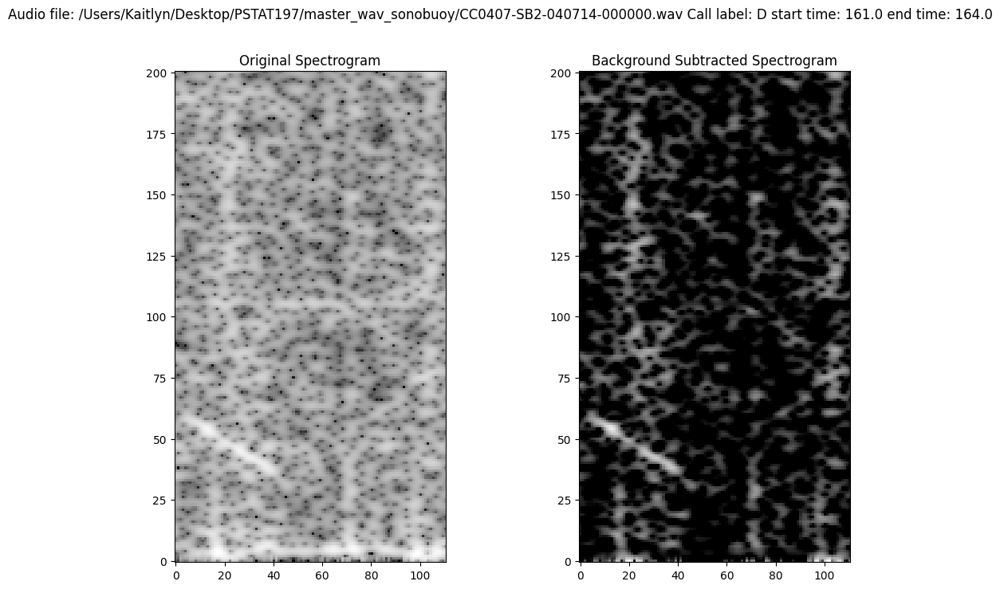

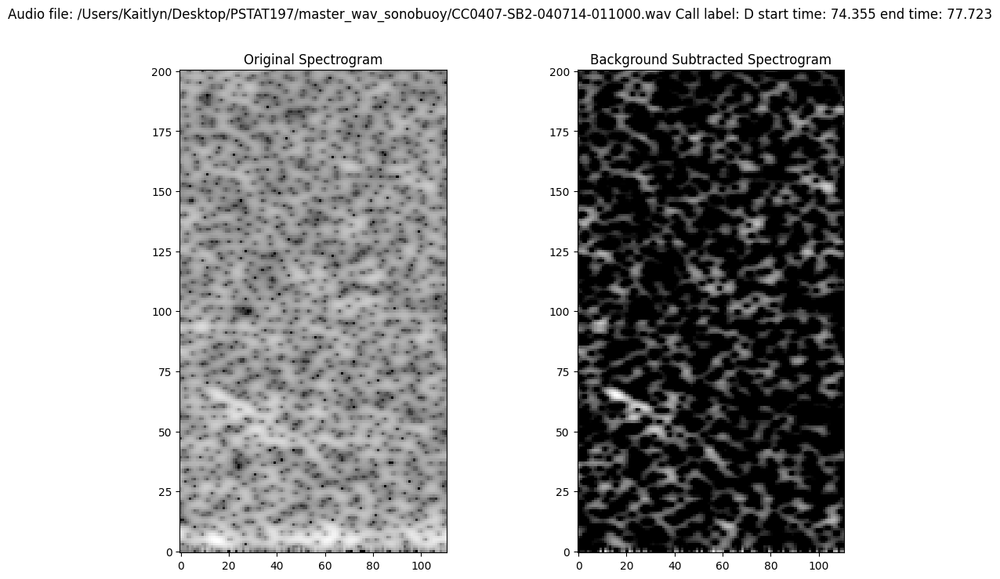

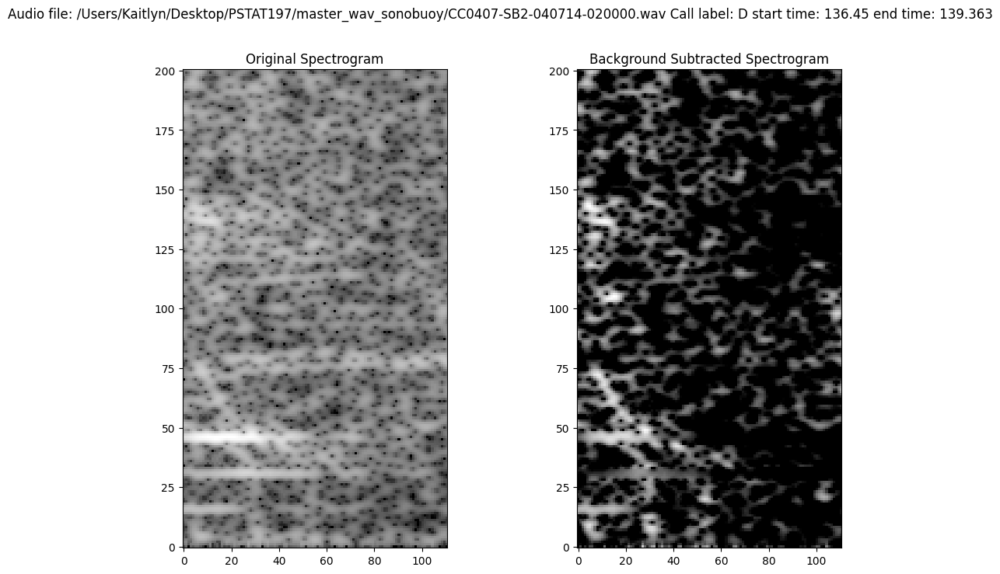

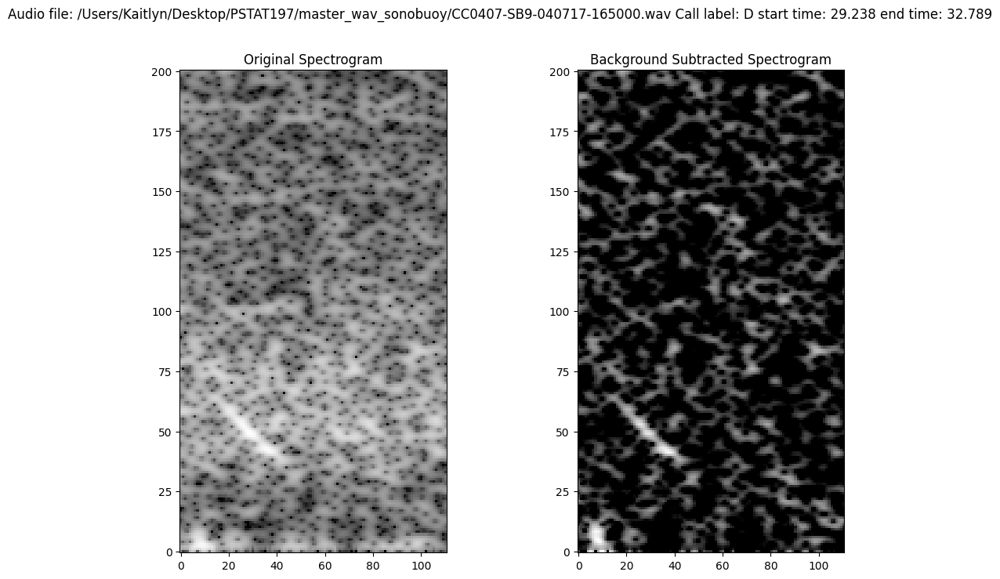

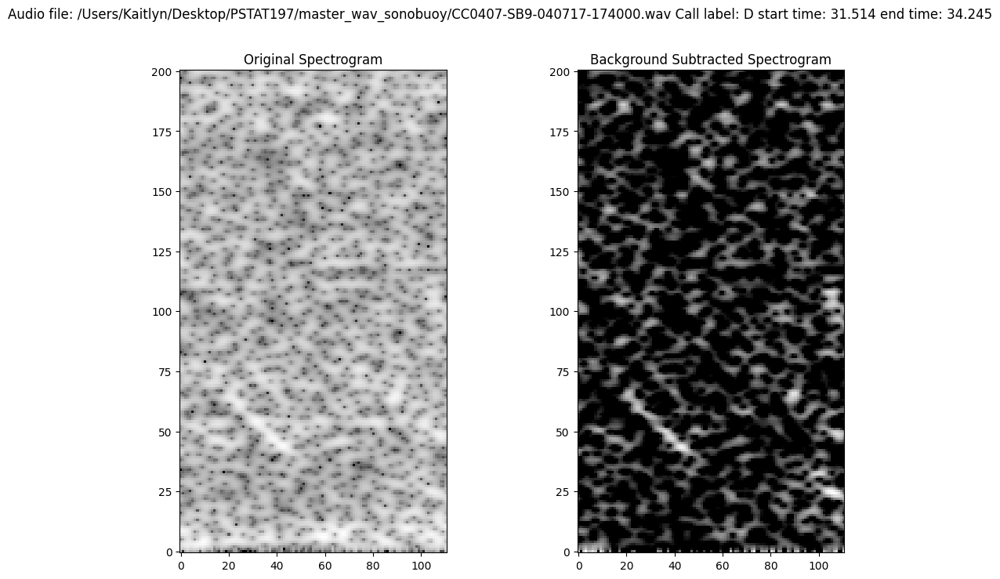

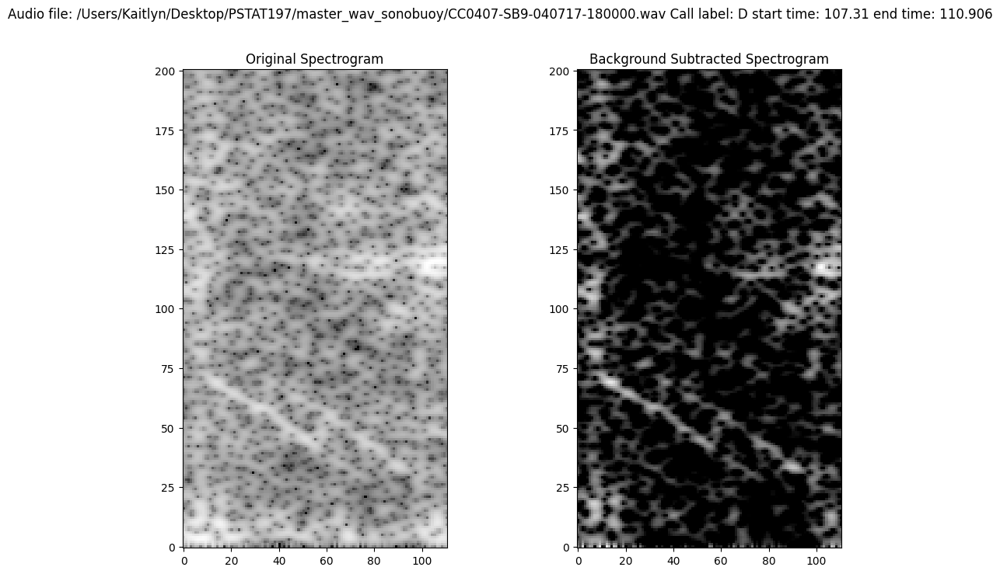

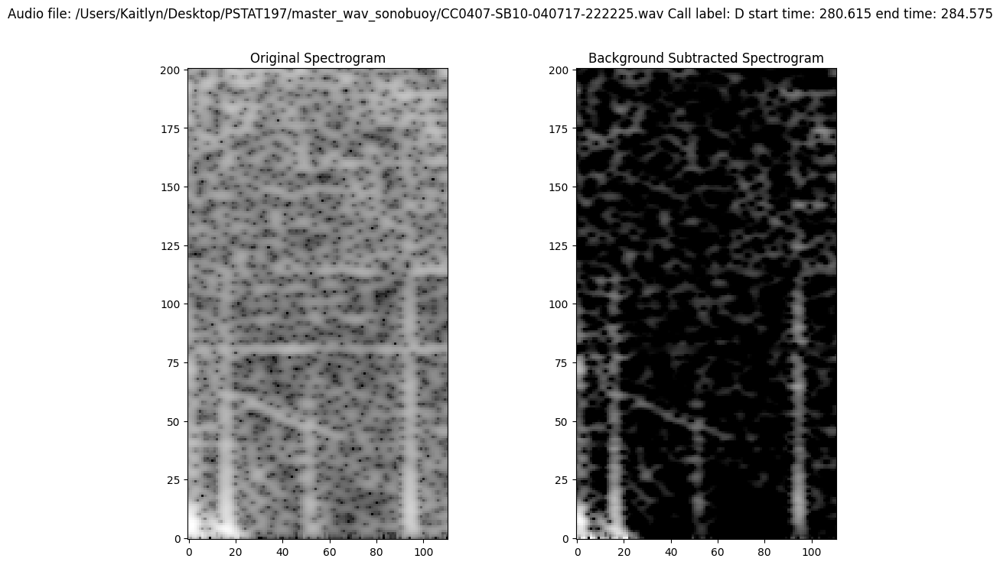

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/opensoundscape/audio.py:328: UserWarning: audio object has zero samples
  warnings.warn(error_msg)


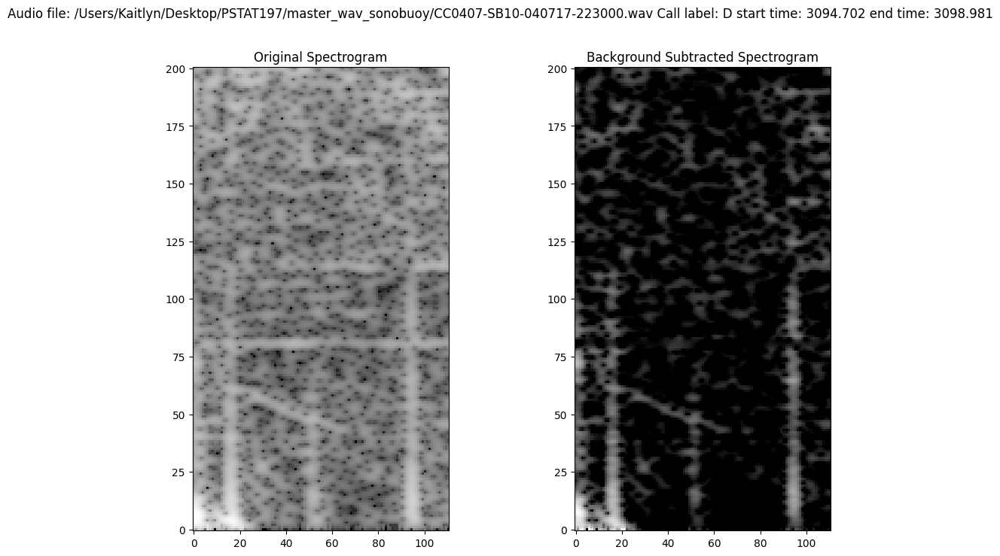

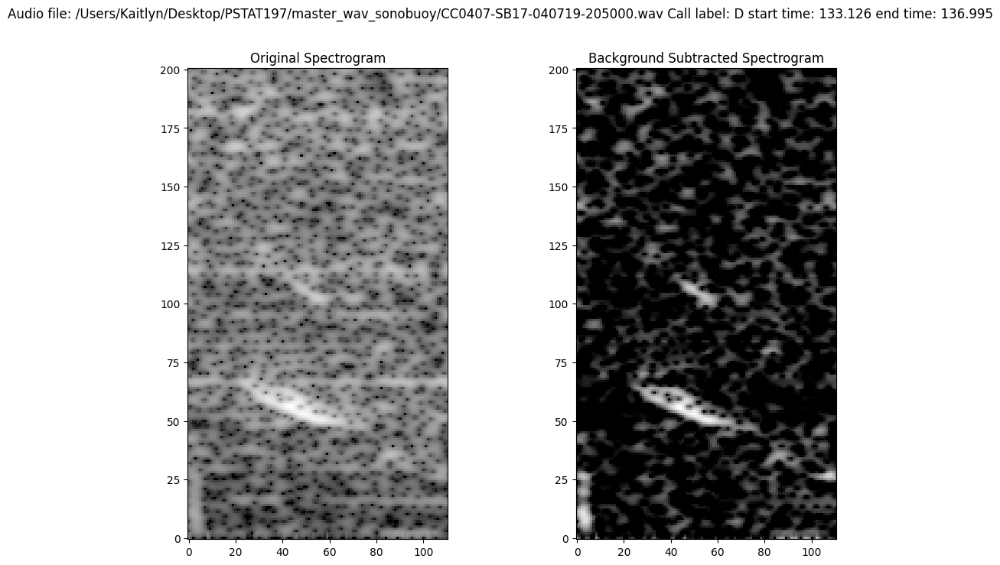

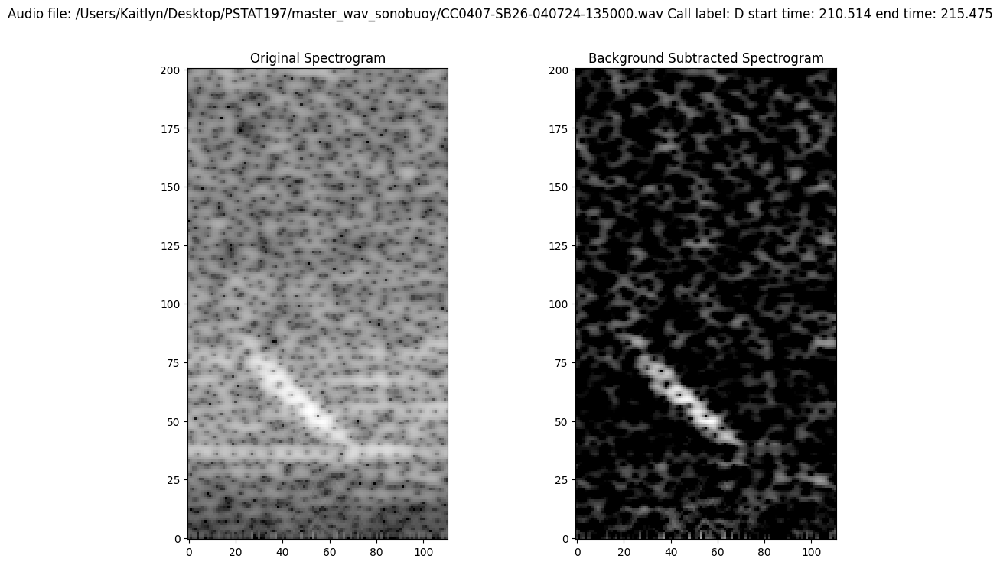

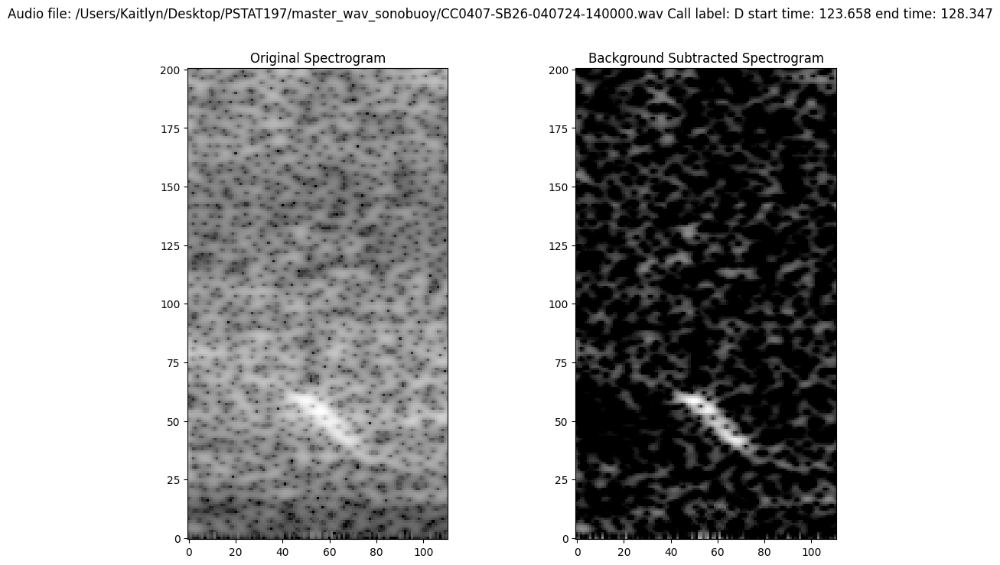

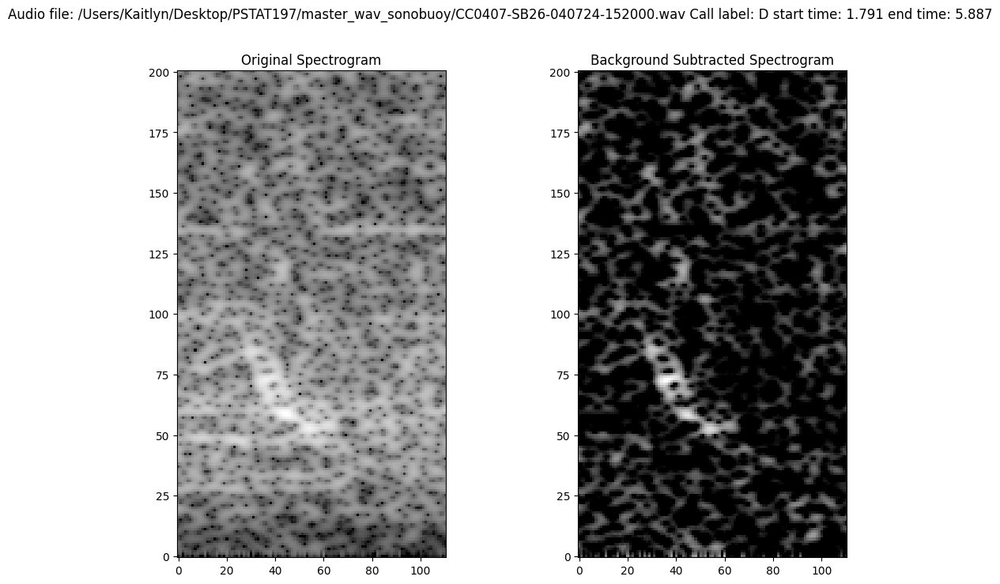

...

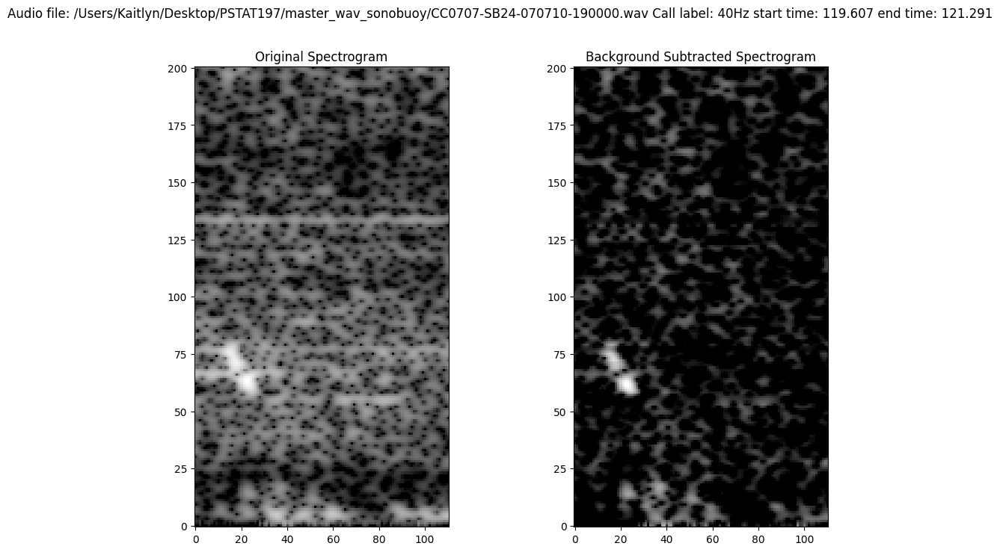

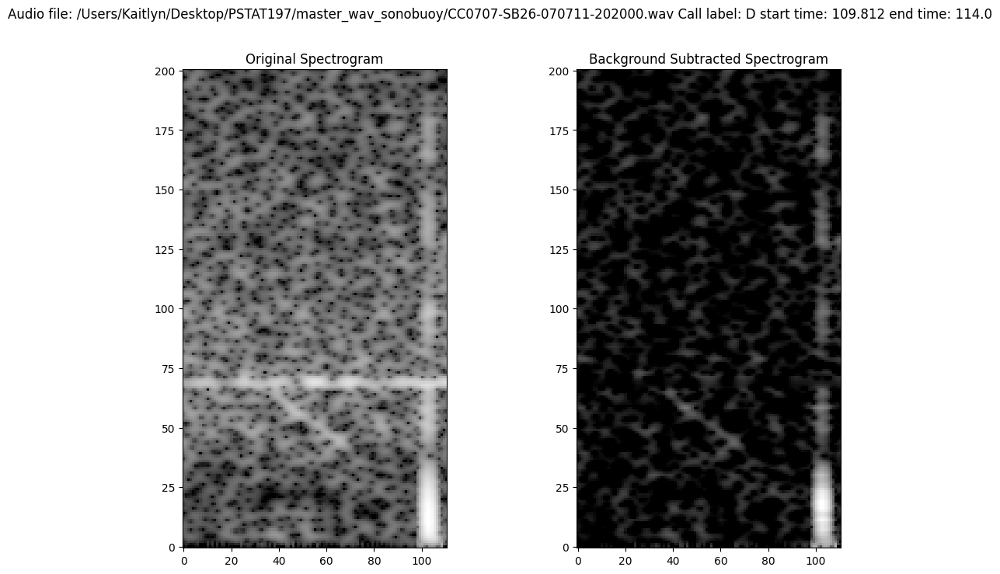

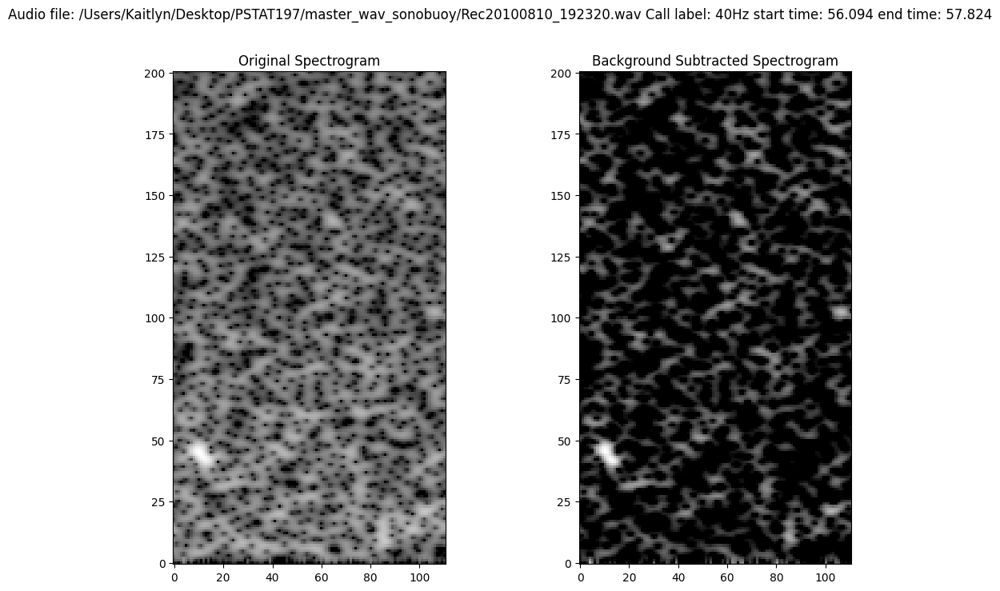

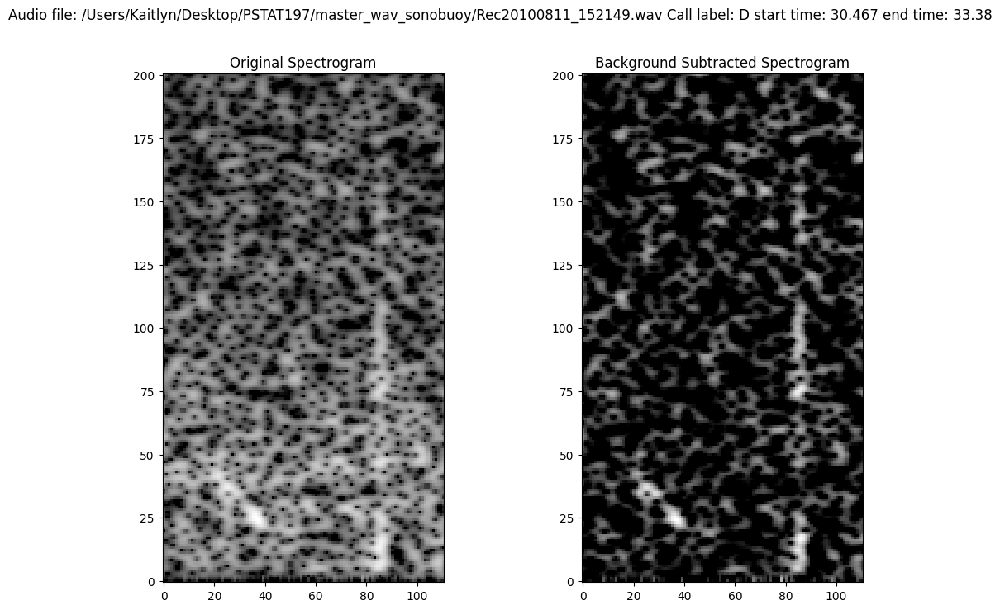

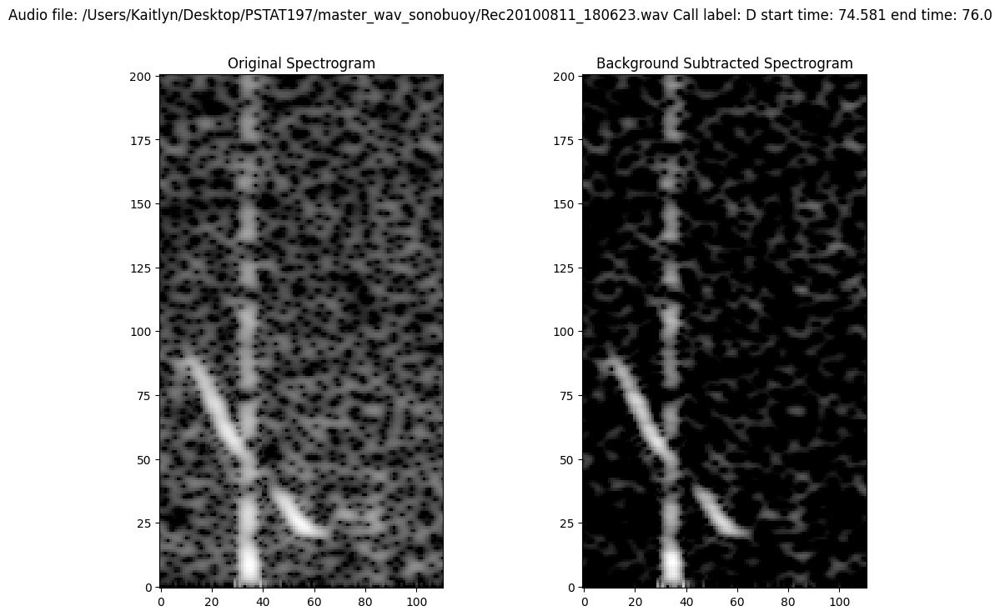

In [251]:
# Same code as above, just plotting all consecutively:

for index, row in CC_2004_07.iterrows():
    # audio file name
    audio_file_name = CC_2004_07['audio_file'][index]
    start_time = CC_2004_07['start_time'][index]

    # collecting audio
    audio = opensoundscape.Audio.from_file(audio_file_name, sample_rate=48000, offset=start_time, duration=6)

    if audio.samples.shape[0] > 0:  # Assuming audio.samples returns a numpy array of audio samples
        spec = opensoundscape.Spectrogram.from_audio(audio, window_type='hamming', window_samples=24000, 
                                                        overlap_samples=21600, fft_size=48000, 
                                                        scaling='density')

    # storing image as 2 dim array
    spec_image = spec.bandpass(0, 200).to_image()
    spec_image_arr = np.array(spec_image).astype(float)

    # collecting portion of image containing only noise
    background_noise_model = np.mean(spec_image_arr[:, :100], axis=1)

    # Subtract the background noise model from each column of the spectrogram
    spec_image_arr_mod2 = spec_image_arr.copy()
    for i in range(spec_image_arr.shape[1]):
        spec_image_arr_mod2[:, i] -= background_noise_model

    # apply threshold to filter out parts of the background ( difference between background and foreground image)
    spec_image_arr_mod3 = spec_image_arr_mod2.copy()
    spec_image_arr_mod3[spec_image_arr_mod3 < 0 ] = 0

    # Plot the original and transformed spectrograms side by side
    fig, axes = plt.subplots(1, 2, figsize=(12, 8))

    # Plot original spectrogram
    axes[0].imshow(np.flipud(spec_image_arr), cmap='gray', origin='lower')
    axes[0].set_title('Original Spectrogram')

    # Plot transformed spectrogram
    axes[1].imshow(np.flipud(spec_image_arr_mod3), cmap='gray', origin='lower')
    axes[1].set_title('Background Subtracted Spectrogram')

    plt.suptitle(f'Audio file: {audio_file_name} Call label: {row["annotation"]} start time: {row["start_time"]} end time: {row["end_time"]}')
    plt.show()



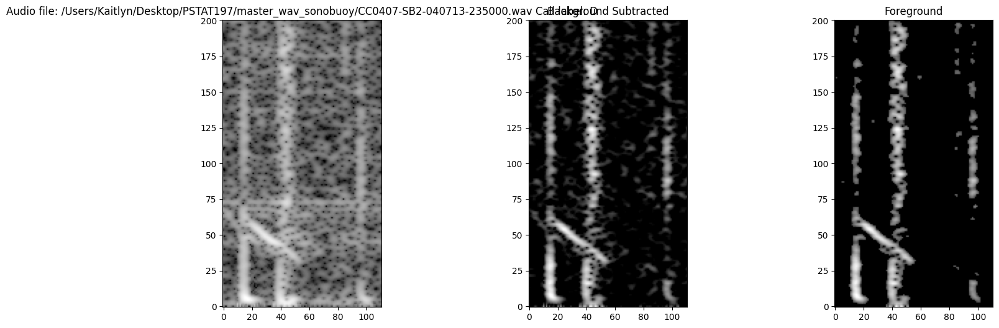

<Figure size 640x480 with 0 Axes>

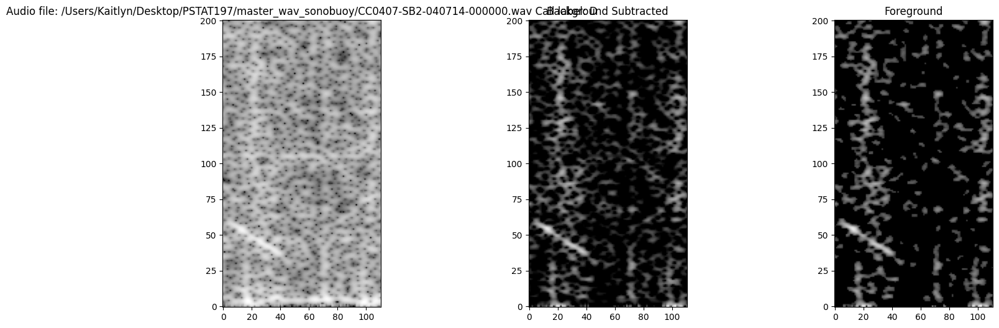

<Figure size 640x480 with 0 Axes>

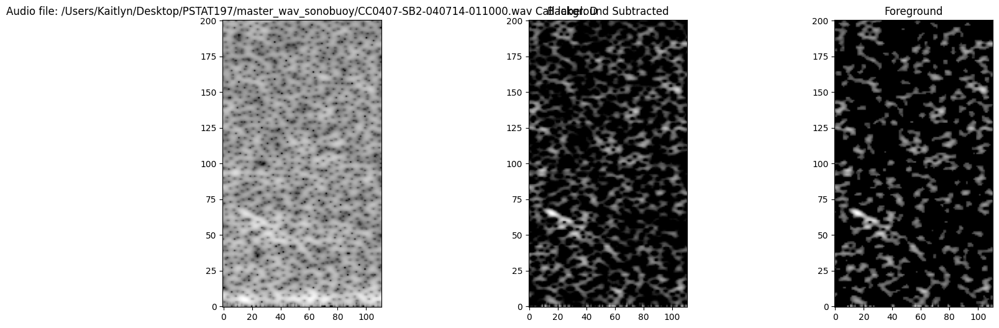

<Figure size 640x480 with 0 Axes>

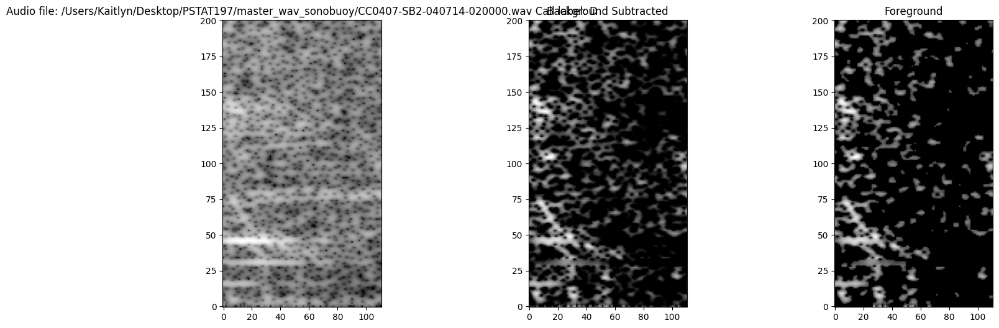

<Figure size 640x480 with 0 Axes>

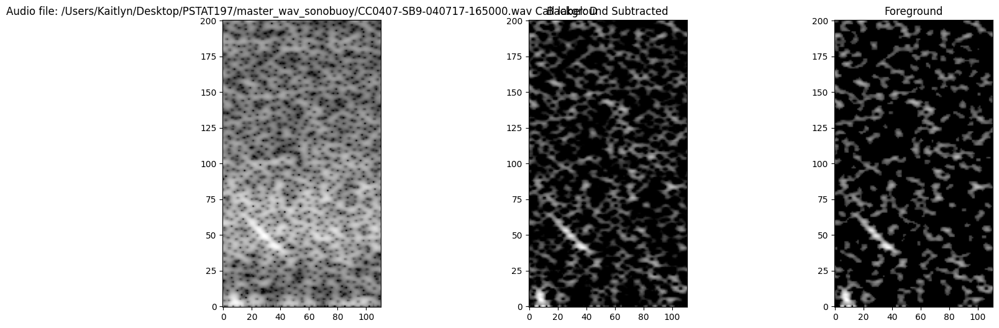

<Figure size 640x480 with 0 Axes>

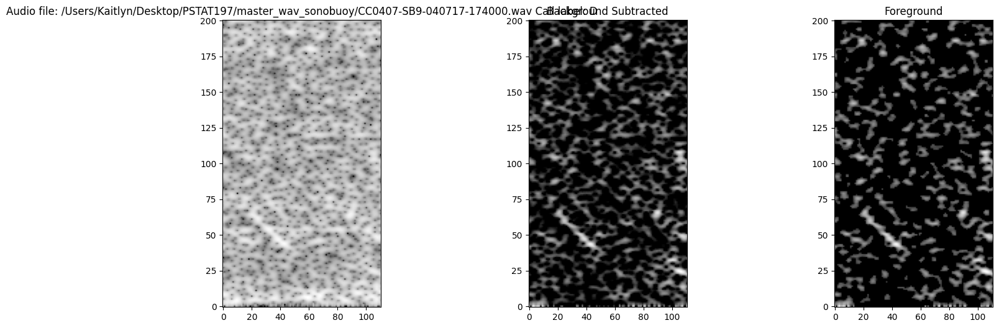

<Figure size 640x480 with 0 Axes>

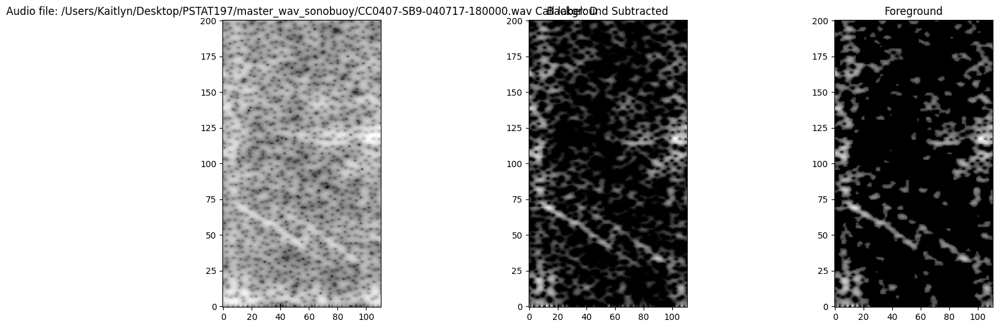

<Figure size 640x480 with 0 Axes>

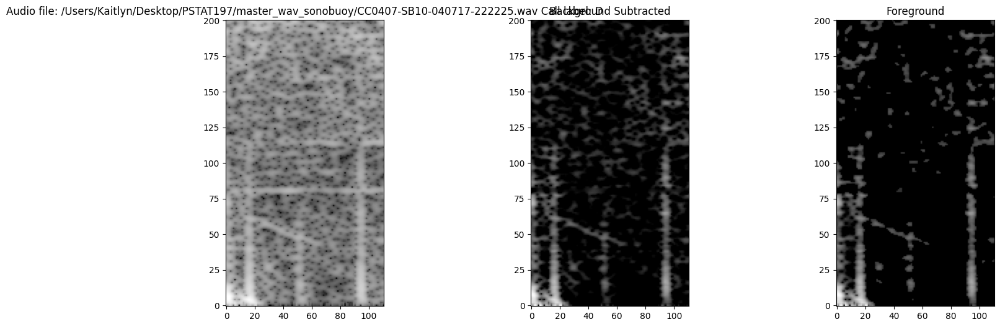

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/opensoundscape/audio.py:328: UserWarning: audio object has zero samples
  warnings.warn(error_msg)


<Figure size 640x480 with 0 Axes>

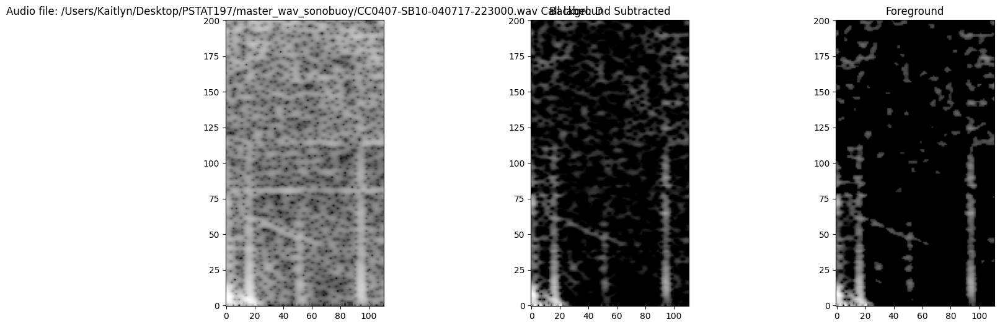

<Figure size 640x480 with 0 Axes>

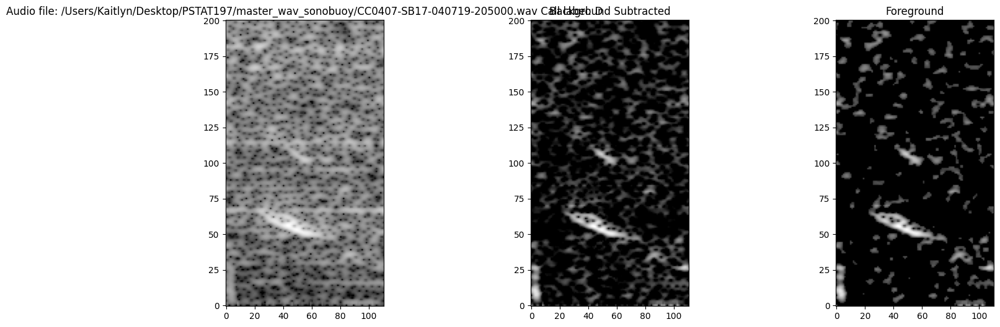

<Figure size 640x480 with 0 Axes>

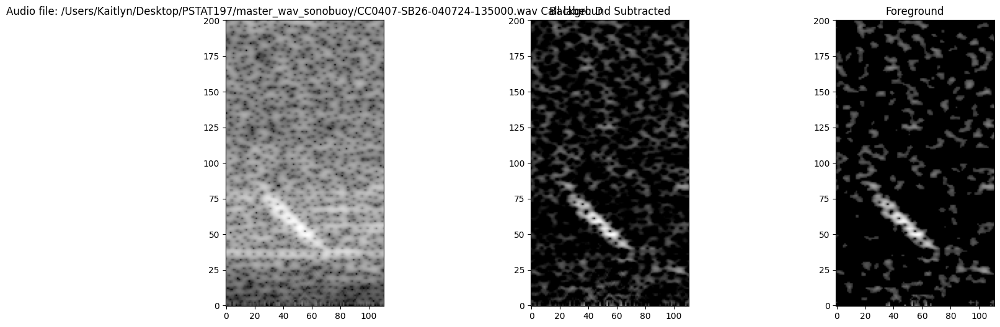

<Figure size 640x480 with 0 Axes>

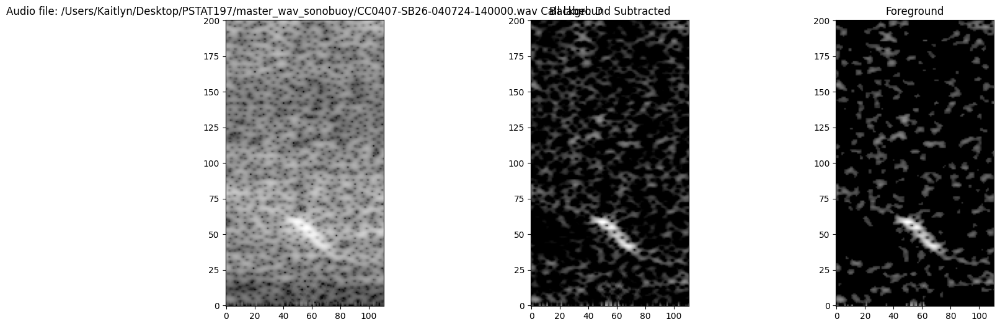

<Figure size 640x480 with 0 Axes>

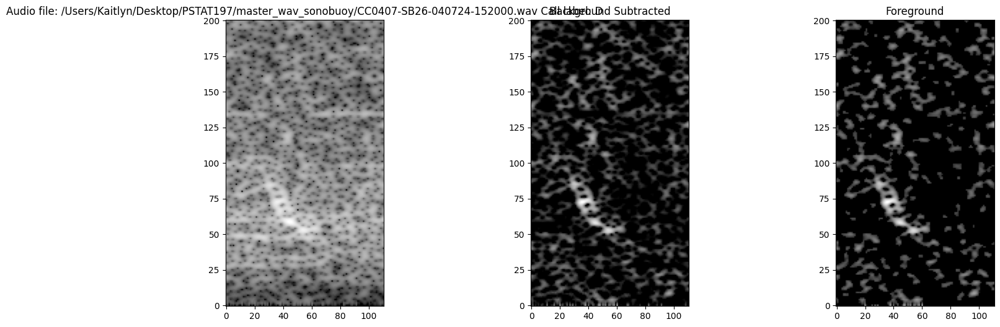

<Figure size 640x480 with 0 Axes>

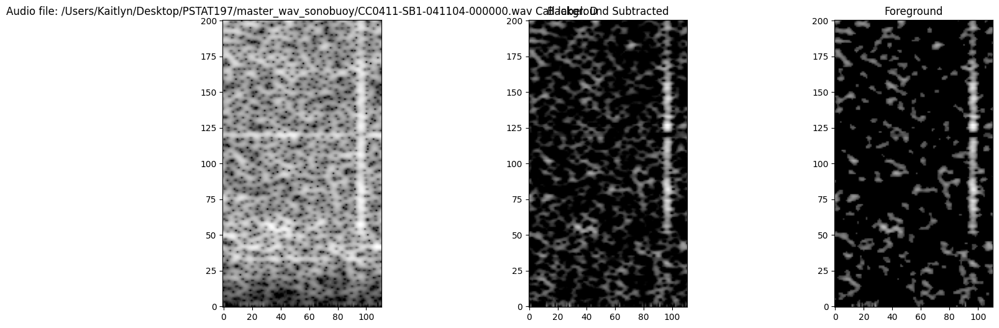

<Figure size 640x480 with 0 Axes>

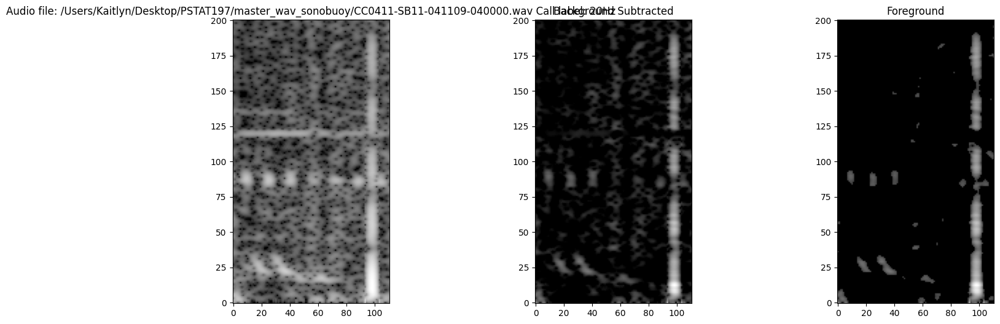

<Figure size 640x480 with 0 Axes>

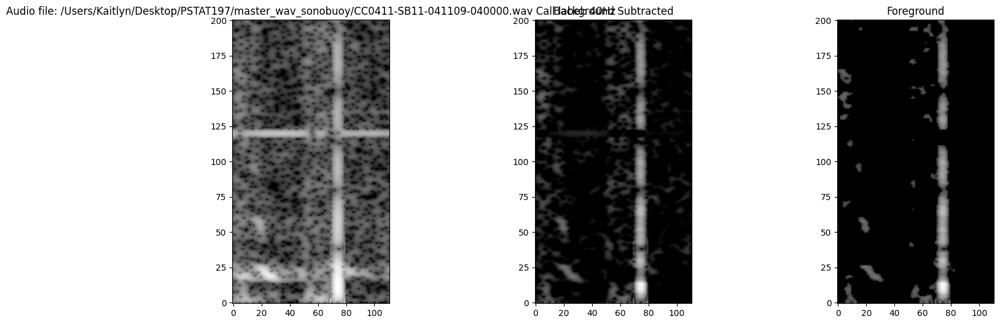

<Figure size 640x480 with 0 Axes>

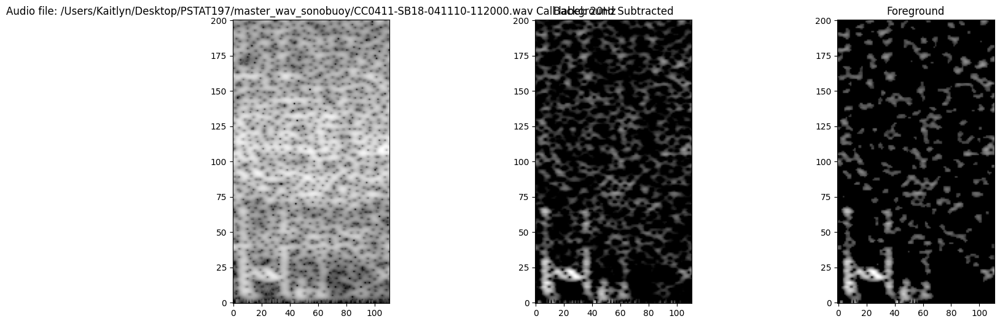

<Figure size 640x480 with 0 Axes>

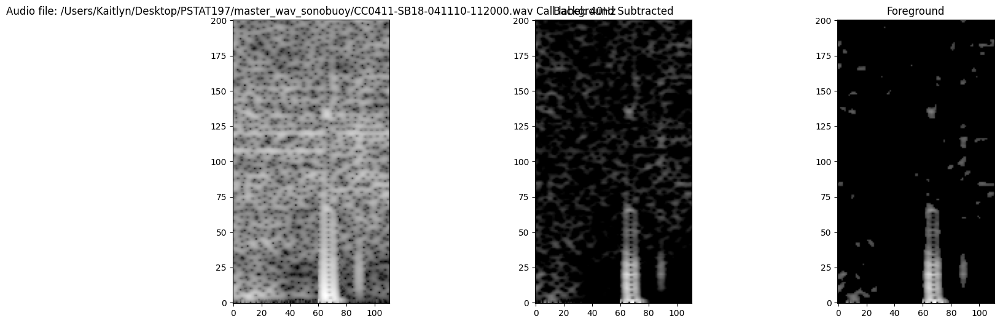

<Figure size 640x480 with 0 Axes>

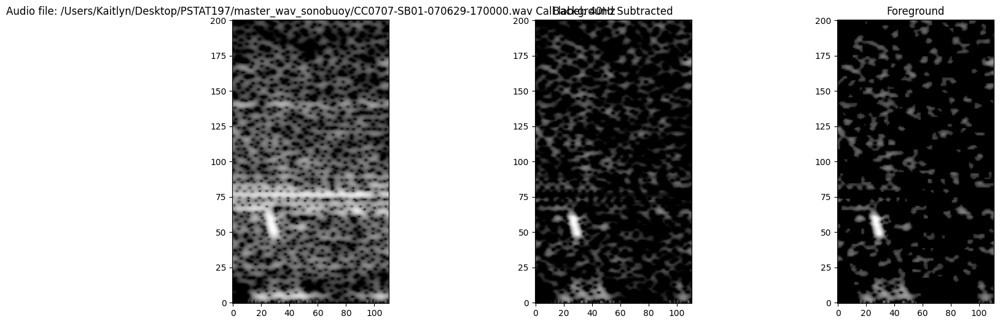

<Figure size 640x480 with 0 Axes>

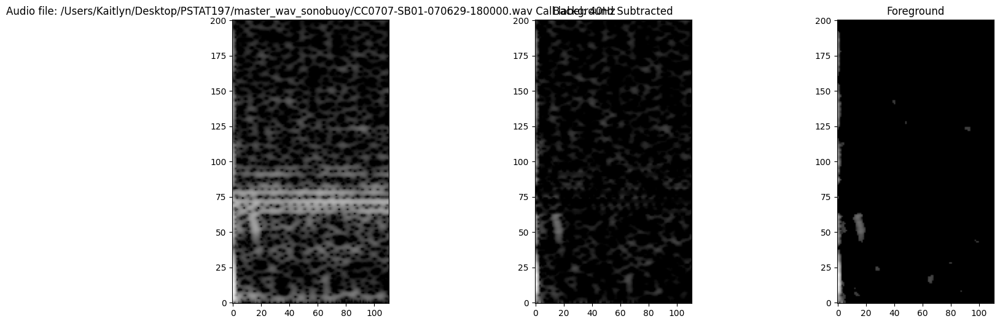

<Figure size 640x480 with 0 Axes>

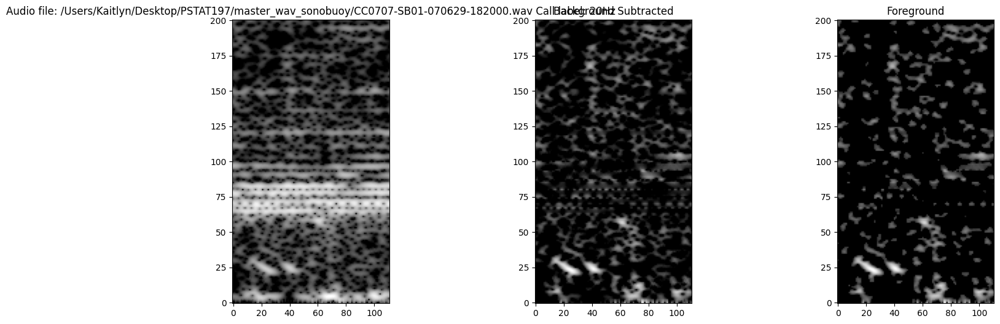

<Figure size 640x480 with 0 Axes>

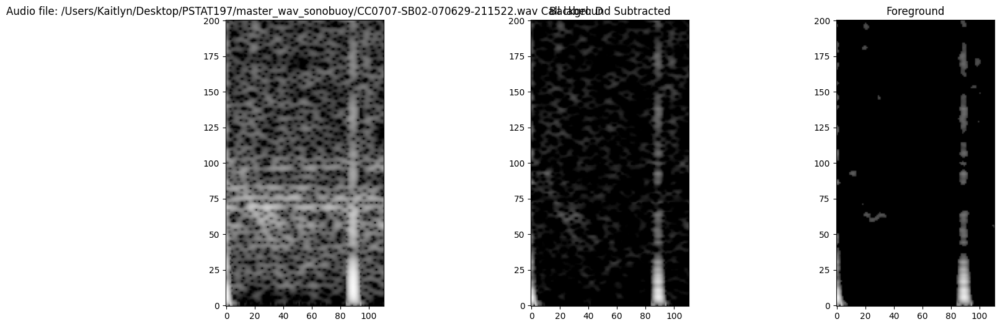

<Figure size 640x480 with 0 Axes>

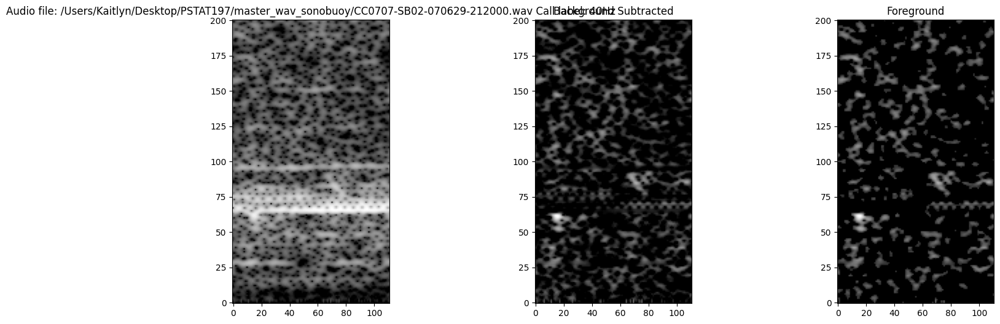

<Figure size 640x480 with 0 Axes>

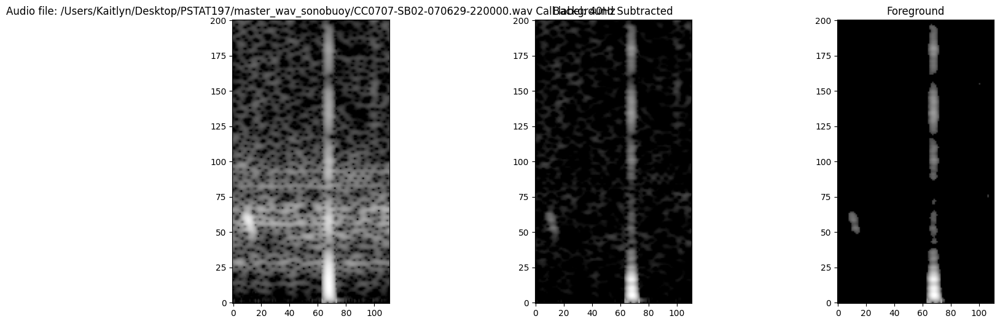

<Figure size 640x480 with 0 Axes>

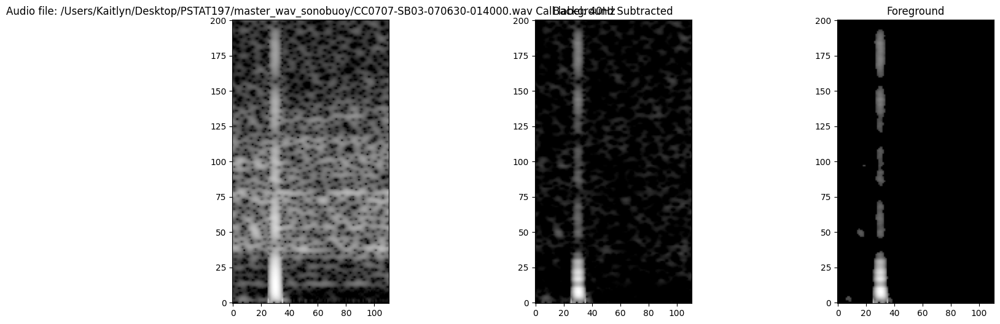

<Figure size 640x480 with 0 Axes>

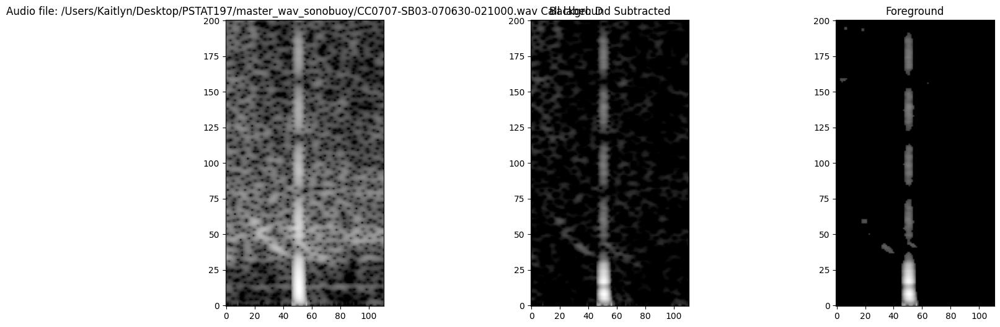

<Figure size 640x480 with 0 Axes>

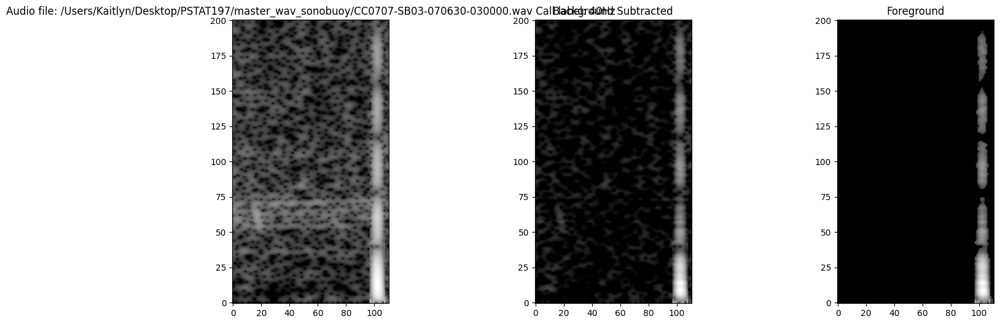

<Figure size 640x480 with 0 Axes>

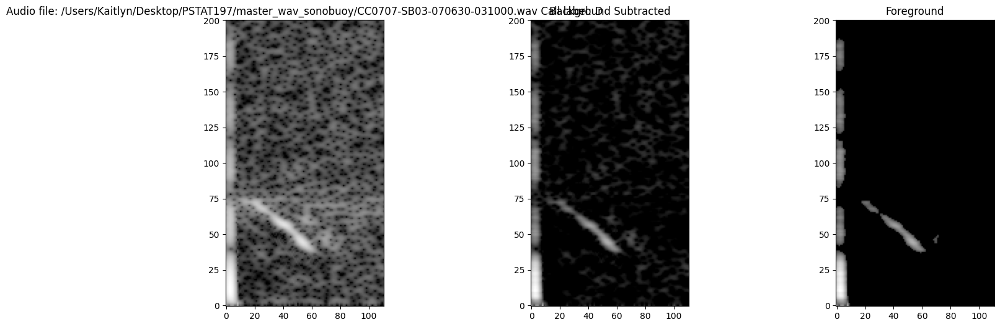

<Figure size 640x480 with 0 Axes>

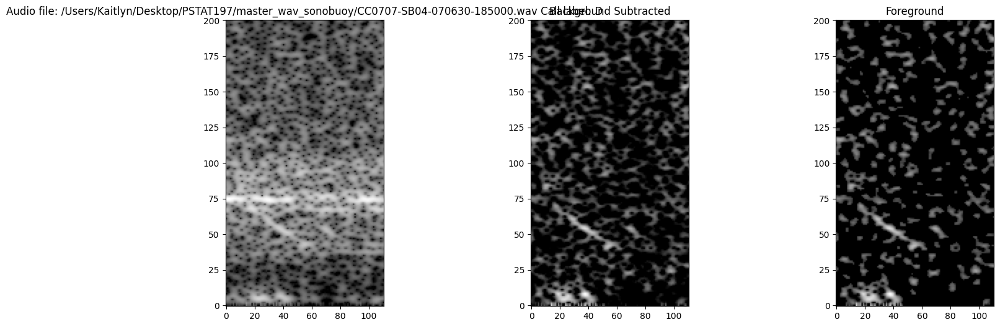

<Figure size 640x480 with 0 Axes>

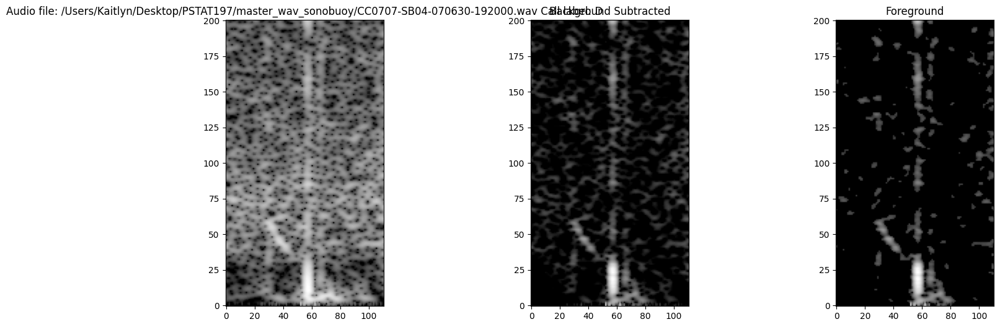

<Figure size 640x480 with 0 Axes>

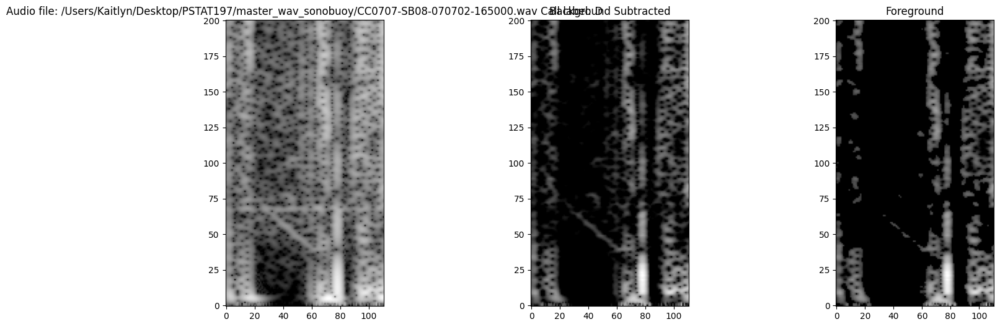

<Figure size 640x480 with 0 Axes>

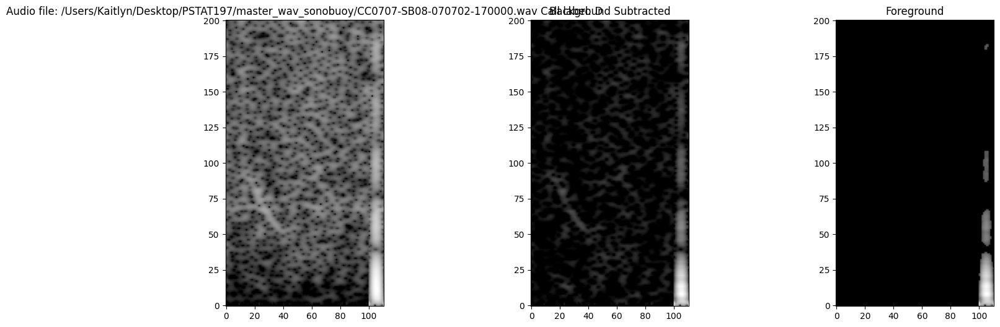

<Figure size 640x480 with 0 Axes>

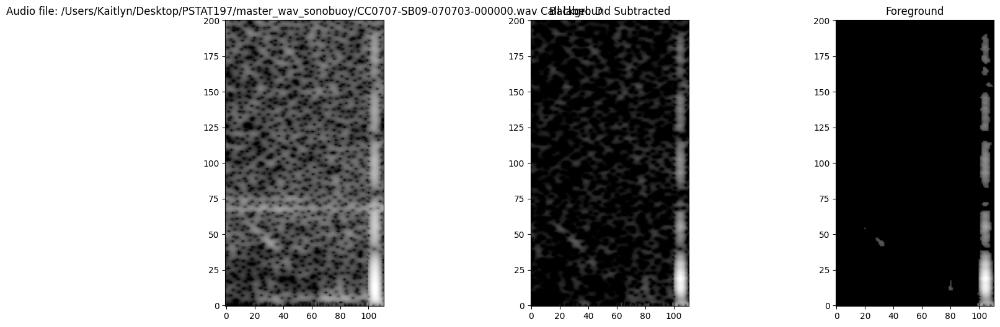

<Figure size 640x480 with 0 Axes>

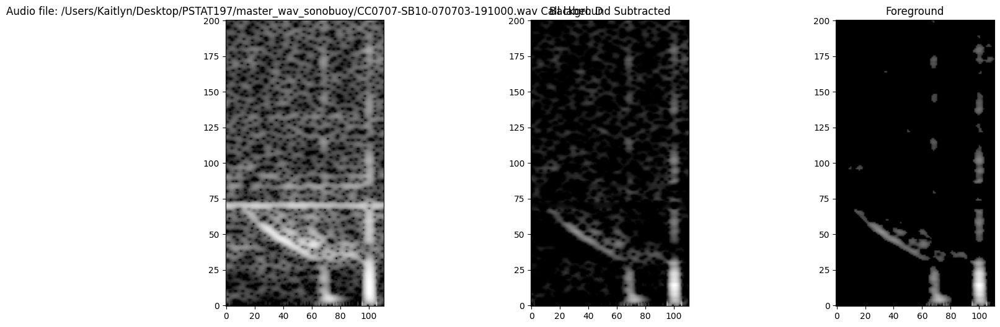

<Figure size 640x480 with 0 Axes>

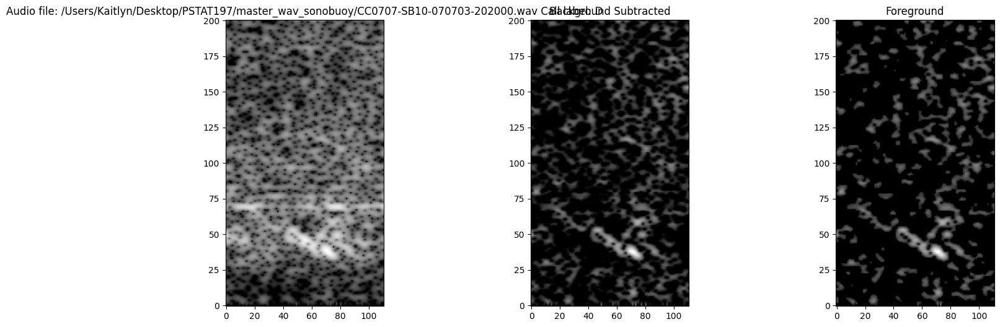

<Figure size 640x480 with 0 Axes>

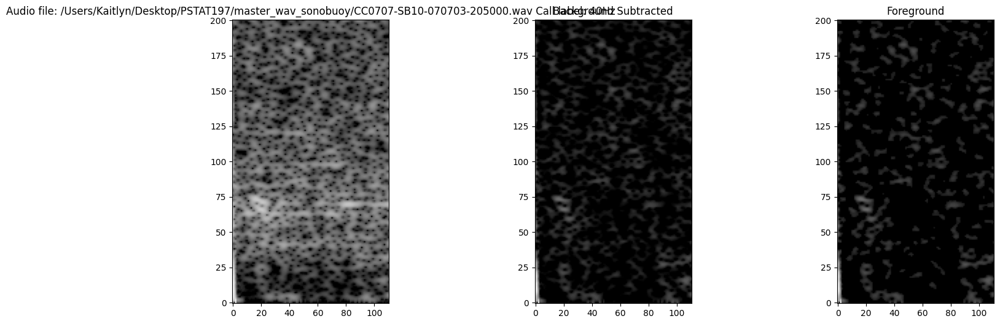

<Figure size 640x480 with 0 Axes>

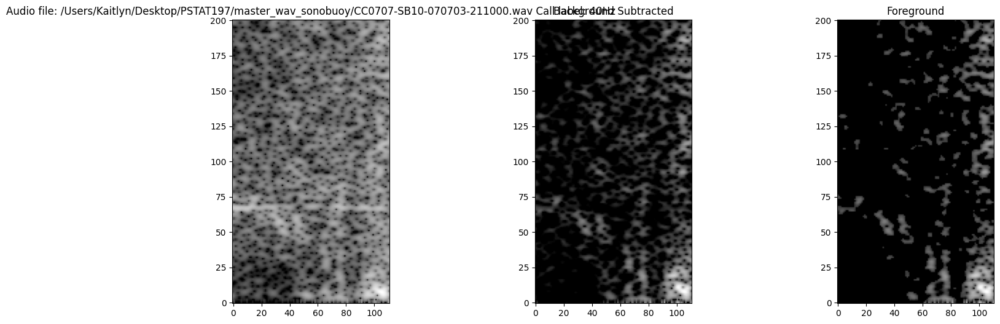

<Figure size 640x480 with 0 Axes>

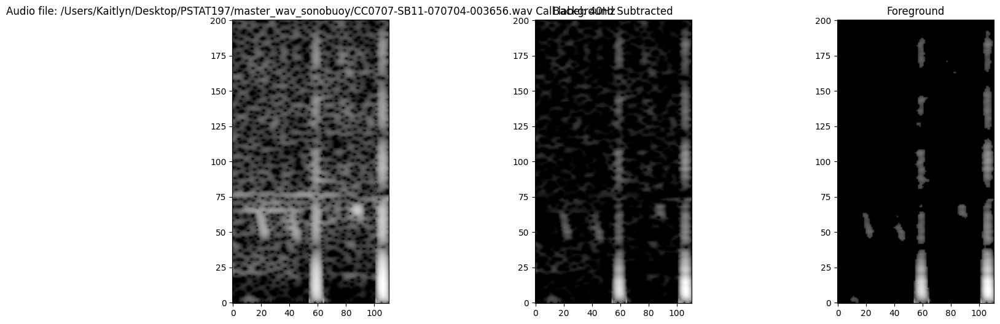

<Figure size 640x480 with 0 Axes>

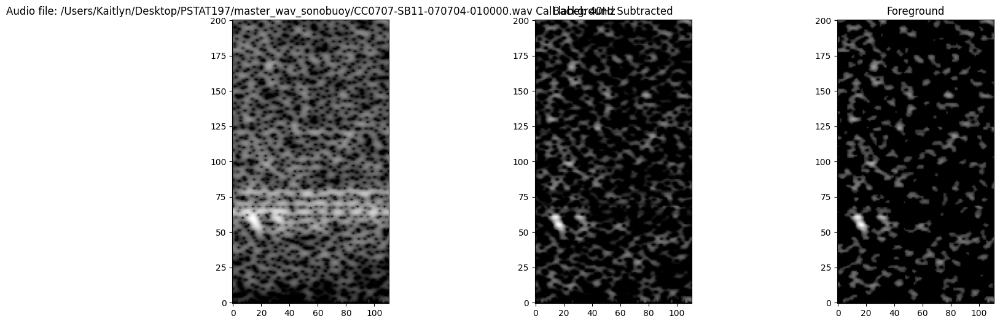

<Figure size 640x480 with 0 Axes>

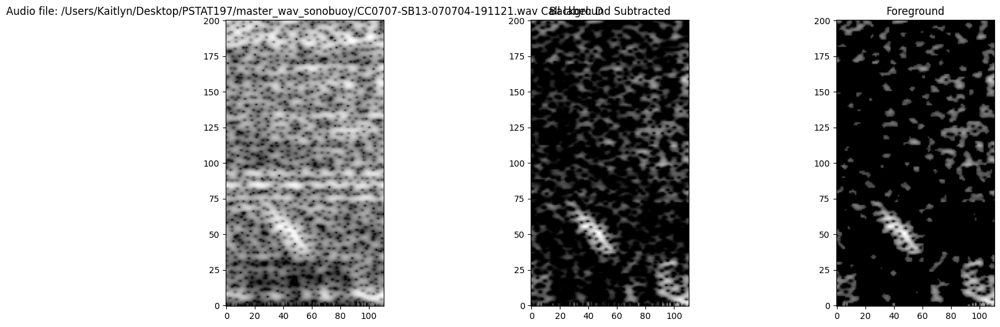

<Figure size 640x480 with 0 Axes>

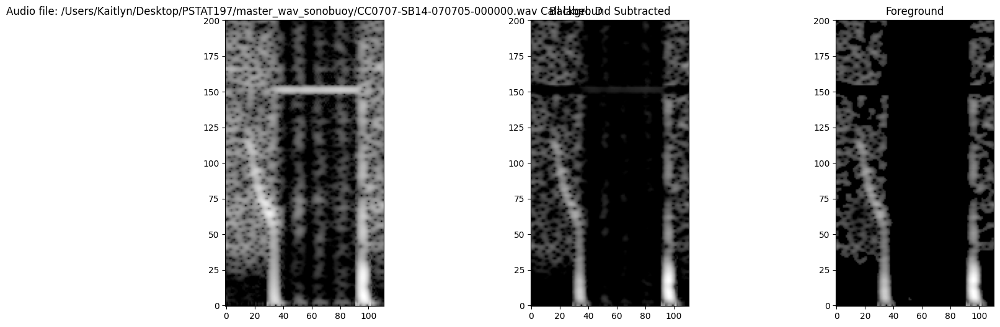

<Figure size 640x480 with 0 Axes>

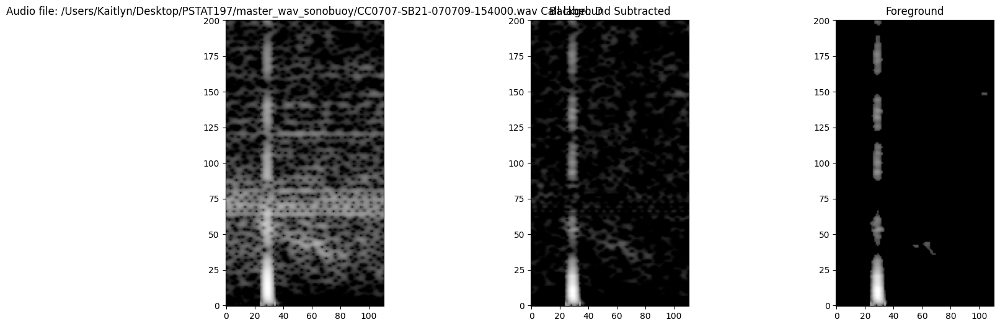

<Figure size 640x480 with 0 Axes>

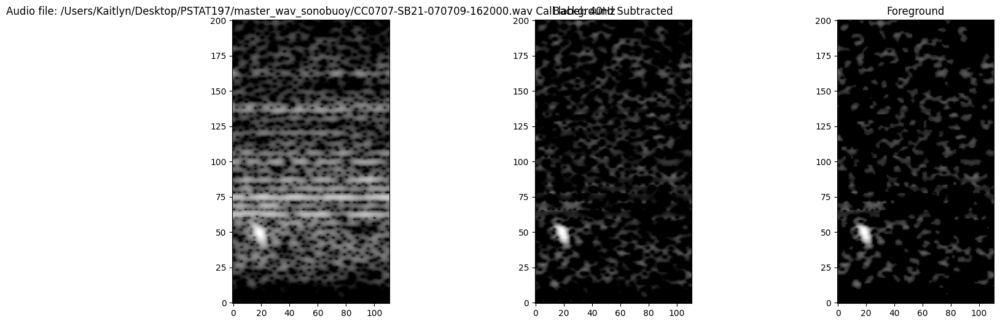

<Figure size 640x480 with 0 Axes>

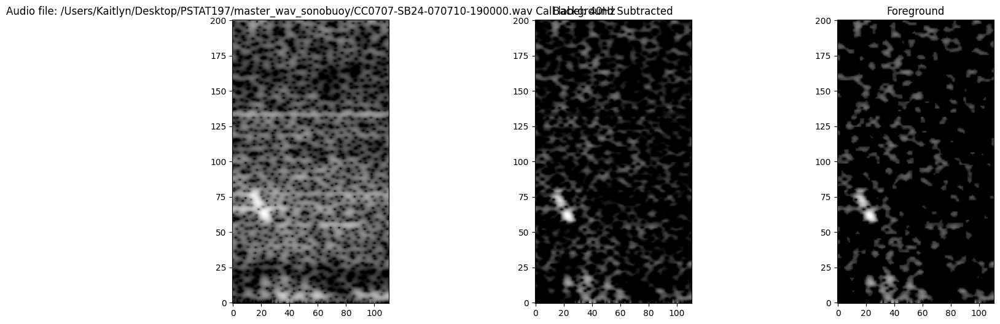

<Figure size 640x480 with 0 Axes>

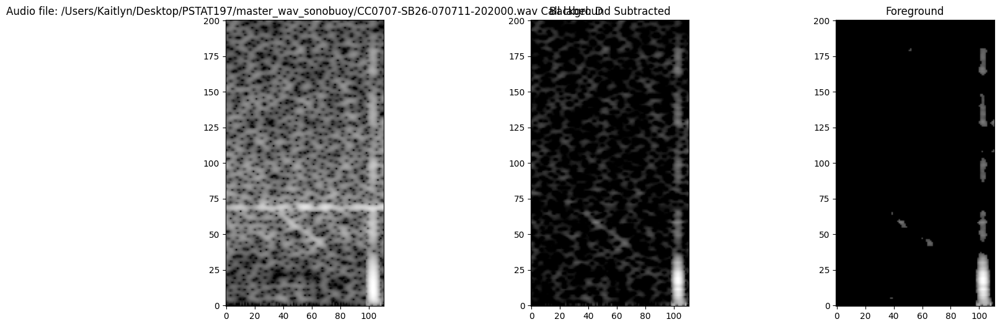

<Figure size 640x480 with 0 Axes>

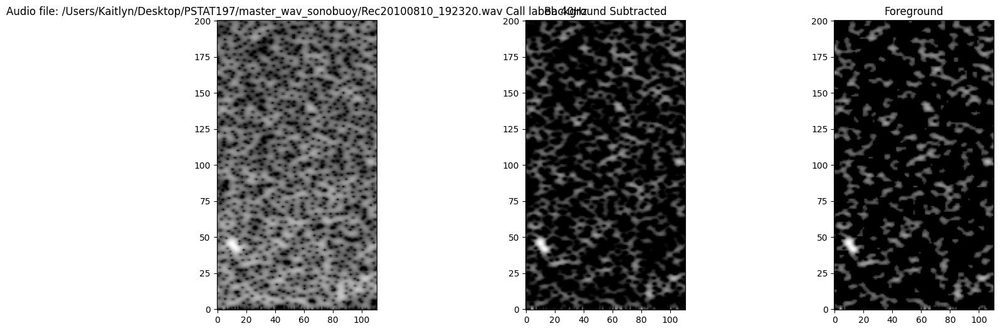

<Figure size 640x480 with 0 Axes>

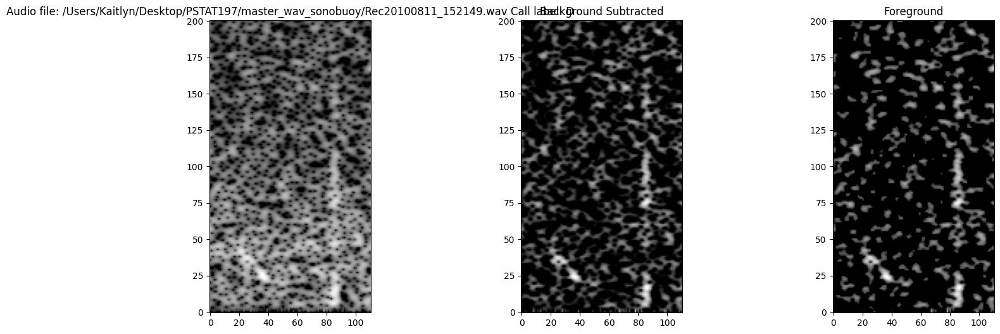

<Figure size 640x480 with 0 Axes>

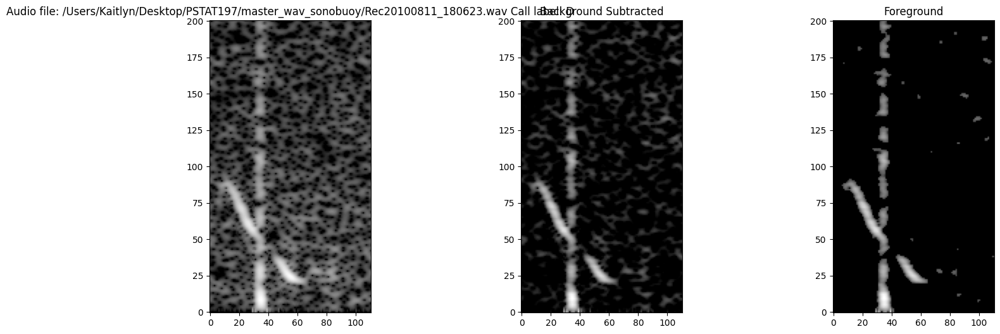

<Figure size 640x480 with 0 Axes>

In [266]:
# Applying Bilateral filter on top of background subtraction:

for index, row in CC_2004_07.iterrows():
    # audio file name
    audio_file_name = CC_2004_07['audio_file'][index]
    start_time = CC_2004_07['start_time'][index]

    # collecting audio
    audio = opensoundscape.Audio.from_file(audio_file_name, sample_rate=48000, offset=start_time, duration=6)

    if audio.samples.shape[0] > 0:  # Assuming audio.samples returns a numpy array of audio samples
        spec = opensoundscape.Spectrogram.from_audio(audio, window_type='hamming', window_samples=24000, 
                                                        overlap_samples=21600, fft_size=48000, 
                                                        scaling='density')

    # storing image as 2 dim array
    spec_image = spec.bandpass(0, 200).to_image()
    spec_image_arr = np.array(spec_image).astype(float)

    # collecting portion of image containing only noise
    background_noise_model = np.mean(spec_image_arr[:, :100], axis=1)

    # Subtract the background noise model from each column of the spectrogram
    spec_image_arr_mod2 = spec_image_arr.copy()
    for i in range(spec_image_arr.shape[1]):
        spec_image_arr_mod2[:, i] -= background_noise_model

    # apply threshold to filter out parts of the background ( difference between background and foreground image)
    spec_image_arr_mod3 = spec_image_arr_mod2.copy()
    spec_image_arr_mod3[spec_image_arr_mod3 < 0 ] = 0


    gray_spec = spec_image_arr_mod3.astype(np.uint8)

    # Apply bilateral filter to smooth the image and reduce noise
    blurred_spec = cv2.bilateralFilter(gray_spec, 4, 50, 50)

    # Use adaptive thresholding to separate the foreground from the background
    _, thresh = cv2.threshold(blurred_spec, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Find contours of the thresholded image
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Create an empty mask to store the foreground
    mask = np.zeros_like(gray_spec)

    # Draw the contours on the mask
    cv2.drawContours(mask, contours, -1, 255, thickness=cv2.FILLED)

    # Perform bitwise_and to get the foreground
    foreground = cv2.bitwise_and(gray_spec, mask)

    # Subtract the background from the original spectrogram
    background_subtracted_spec = gray_spec - foreground



    # Plot the original and transformed spectrograms side by side
    plt.figure(figsize=(18, 6))

    plt.subplot(131)
    plt.imshow(np.flipud(spec_image), cmap='gray', origin='lower')
    plt.title(f'Audio file: {audio_file_name} Call label: {row["annotation"]}')

    plt.subplot(132)
    plt.imshow(np.flipud(spec_image_arr_mod3), cmap='gray', origin='lower')
    plt.title('Background Subtracted')

    plt.subplot(133)
    plt.imshow(np.flipud(foreground), cmap='gray', origin='lower')
    plt.title('Foreground')

    plt.show()
    plt.suptitle(f'Audio file: {audio_file_name} Call label: {row["annotation"]} start time: {row["start_time"]} end time: {row["end_time"]}')